In [0]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [0]:
import os
os.chdir("/content/drive/My Drive/fast-neural-style-pytorch-master")
os.getcwd()

'/content/drive/My Drive/fast-neural-style-pytorch-master'

In [0]:
from __future__ import print_function
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from PIL import Image
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
import torchvision.models as models
import copy
import os
from google.colab import drive
import cv2
from google.colab.patches import cv2_imshow
from torchvision import datasets, transforms

# fast nerual transfer
# content and style loss

In [0]:
class Normal(nn.Module):
    def __init__(self):
        super(Normal, self).__init__()
        self.mean = torch.tensor([0.485, 0.456, 0.406]).to(device).view(-1, 1, 1)
        self.std = torch.tensor([0.229, 0.224, 0.225]).to(device).view(-1, 1, 1)

    def forward(self, img):
        # normalize img
        return (img - self.mean) / self.std
 
class LossOfContent(nn.Module):
  def __init__(self,goal):
      super(LossOfContent,self).__init__()
      self.goal_feature = goal.detach()
      
  def forward(self,items):
      self.loss = F.mse_loss(items, self.goal_feature)
      return items

class LossOfStyle(nn.Module):

  def __init__(self, target_feature):
      super(LossOfStyle, self).__init__()
      self.target = gram_matrix(target_feature).detach()

  def forward(self, input):
      G = gram_matrix(input)
      self.loss = F.mse_loss(G, self.target)
      return input

def gram_matrix(inputs):
  in_n, in_h, in_w, in_c =inputs.size()
  new_inputs_curr = inputs.view(in_n, in_h ,in_c * in_w)
  gram_matrix_result = torch.bmm(new_inputs_curr,new_inputs_curr.transpose(1,2))
  all_G = gram_matrix_result.div(in_n * in_h * in_w * in_c)
  return all_G
  

def get_model(cnn, style_img, content_img):
  cnn = copy.deepcopy(cnn)
  Normal1 = Normal().to(device)
  content_losses = []
  style_losses = []
  model = nn.Sequential(Normal1)
  for index, layer in enumerate(cnn.children()):
      name = '{}'.format(index)
      model.add_module(name, layer)
      if index in [3, 8, 17, 22, 26, 35]:
          target_feature = model(style_img)
          style_loss = LossOfStyle(target_feature)
          style_losses.append(style_loss)
          model.add_module("{}_{}".format(index,"style"), style_loss)
          if index == 8:
              target_content = model(content_img)
              content_loss = LossOfContent(target_content)
              content_losses.append(content_loss)
              model.add_module("{}_{}".format(index,"content"), content_loss)
          if name == 35:
              break
  return model, style_losses, content_losses


# transformer

In [0]:
# this part is an existing implementation of transformerNetworks

# class TransformerNetwork(nn.Module):
#     """Feedforward Transformation Network without Tanh
#     reference: https://arxiv.org/abs/1603.08155 
#     exact architecture: https://cs.stanford.edu/people/jcjohns/papers/fast-style/fast-style-supp.pdf
#     """
#     def __init__(self):
#         super(TransformerNetwork, self).__init__()
#         self.ConvBlock = nn.Sequential(
#             ConvLayer(3, 32, 9, 1),
#             nn.ReLU(),
#             ConvLayer(32, 64, 3, 2),
#             nn.ReLU(),
#             ConvLayer(64, 128, 3, 2),
#             nn.ReLU()
#         )
#         self.ResidualBlock = nn.Sequential(
#             ResidualLayer(128, 3), 
#             ResidualLayer(128, 3), 
#             ResidualLayer(128, 3), 
#             ResidualLayer(128, 3), 
#             ResidualLayer(128, 3)
#         )
#         self.DeconvBlock = nn.Sequential(
#             DeconvLayer(128, 64, 3, 2, 1),
#             nn.ReLU(),
#             DeconvLayer(64, 32, 3, 2, 1),
#             nn.ReLU(),
#             ConvLayer(32, 3, 9, 1, norm="None")
#         )

#     def forward(self, x):
#         x = self.ConvBlock(x)
#         x = self.ResidualBlock(x)
#         out = self.DeconvBlock(x)
#         return out

# class ConvLayer(nn.Module):
#     def __init__(self, in_channels, out_channels, kernel_size, stride, norm="instance"):
#         super(ConvLayer, self).__init__()
#         # Padding Layers
#         padding_size = kernel_size // 2
#         self.reflection_pad = nn.ReflectionPad2d(padding_size)

#         # Convolution Layer
#         self.conv_layer = nn.Conv2d(in_channels, out_channels, kernel_size, stride)

#         # Normalization Layers
#         self.norm_type = norm
#         if (norm=="instance"):
#             self.norm_layer = nn.InstanceNorm2d(out_channels, affine=True)
#         elif (norm=="batch"):
#             self.norm_layer = nn.BatchNorm2d(out_channels, affine=True)

#     def forward(self, x):
#         x = self.reflection_pad(x)
#         x = self.conv_layer(x)
#         if (self.norm_type=="None"):
#             out = x
#         else:
#             out = self.norm_layer(x)
#         return out

# class ResidualLayer(nn.Module):
#     """
#     Deep Residual Learning for Image Recognition

#     https://arxiv.org/abs/1512.03385
#     """
#     def __init__(self, channels=128, kernel_size=3):
#         super(ResidualLayer, self).__init__()
#         self.conv1 = ConvLayer(channels, channels, kernel_size, stride=1)
#         self.relu = nn.ReLU()
#         self.conv2 = ConvLayer(channels, channels, kernel_size, stride=1)

#     def forward(self, x):
#         identity = x                     # preserve residual
#         out = self.relu(self.conv1(x))   # 1st conv layer + activation
#         out = self.conv2(out)            # 2nd conv layer
#         out = out + identity             # add residual
#         return out

# class DeconvLayer(nn.Module):
#     def __init__(self, in_channels, out_channels, kernel_size, stride, output_padding, norm="instance"):
#         super(DeconvLayer, self).__init__()

#         # Transposed Convolution 
#         padding_size = kernel_size // 2
#         self.conv_transpose = nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding_size, output_padding)

#         # Normalization Layers
#         self.norm_type = norm
#         if (norm=="instance"):
#             self.norm_layer = nn.InstanceNorm2d(out_channels, affine=True)
#         elif (norm=="batch"):
#             self.norm_layer = nn.BatchNorm2d(out_channels, affine=True)

#     def forward(self, x):
#         x = self.conv_transpose(x)
#         if (self.norm_type=="None"):
#             out = x
#         else:
#             out = self.norm_layer(x)
#         return out

# train

Training the style transfer model..
Using Adams as optimizer
Start Optimization
length of train_loader 5635
total loss is : 4.829829216003418
train pcentage:10/5635
transformerNetwork checkpoint file at models/checkpoint_10.pth


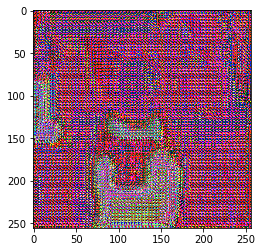

total loss is : 1.8034862279891968
train pcentage:20/5635
transformerNetwork checkpoint file at models/checkpoint_20.pth


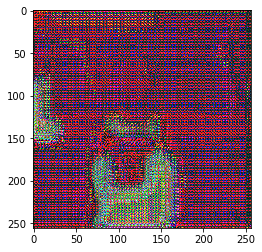

total loss is : 1.7638049125671387
train pcentage:30/5635
transformerNetwork checkpoint file at models/checkpoint_30.pth


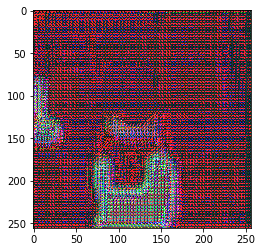

total loss is : 1.3781663179397583
train pcentage:40/5635
transformerNetwork checkpoint file at models/checkpoint_40.pth


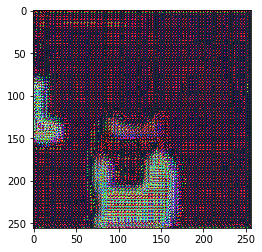

total loss is : 1.4952998161315918
train pcentage:50/5635
transformerNetwork checkpoint file at models/checkpoint_50.pth


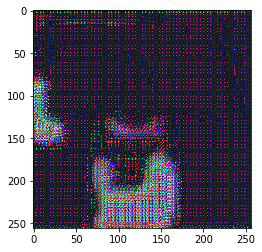

total loss is : 1.2380454540252686
train pcentage:60/5635
transformerNetwork checkpoint file at models/checkpoint_60.pth


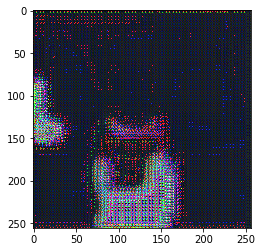

total loss is : 1.26632559299469
train pcentage:70/5635
transformerNetwork checkpoint file at models/checkpoint_70.pth


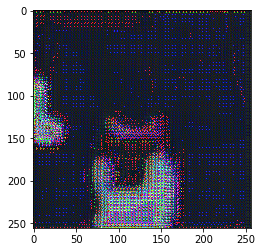

total loss is : 1.0983816385269165
train pcentage:80/5635
transformerNetwork checkpoint file at models/checkpoint_80.pth


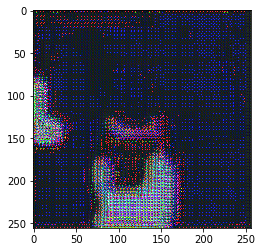

total loss is : 1.248011827468872
train pcentage:90/5635
transformerNetwork checkpoint file at models/checkpoint_90.pth


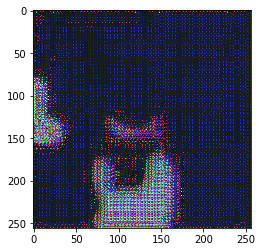

total loss is : 1.150160789489746
train pcentage:100/5635
transformerNetwork checkpoint file at models/checkpoint_100.pth


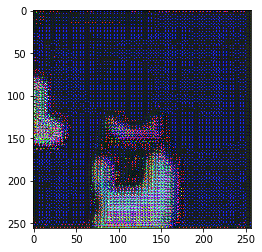

total loss is : 1.1180044412612915
train pcentage:110/5635
transformerNetwork checkpoint file at models/checkpoint_110.pth


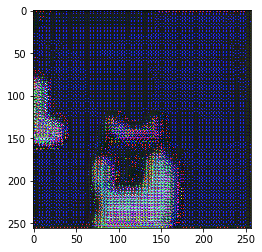

total loss is : 1.3088980913162231
train pcentage:120/5635
transformerNetwork checkpoint file at models/checkpoint_120.pth


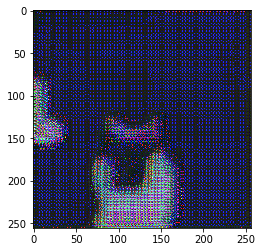

total loss is : 1.245747447013855
train pcentage:130/5635
transformerNetwork checkpoint file at models/checkpoint_130.pth


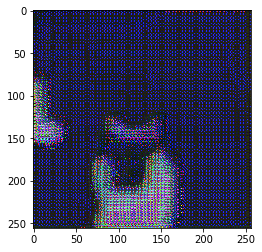

total loss is : 1.0628858804702759
train pcentage:140/5635
transformerNetwork checkpoint file at models/checkpoint_140.pth


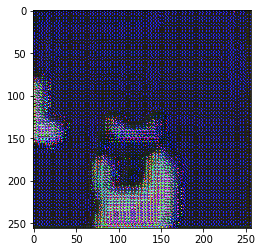

total loss is : 1.100526213645935
train pcentage:150/5635
transformerNetwork checkpoint file at models/checkpoint_150.pth


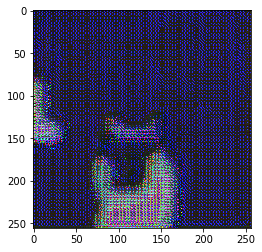

total loss is : 1.1218969821929932
train pcentage:160/5635
transformerNetwork checkpoint file at models/checkpoint_160.pth


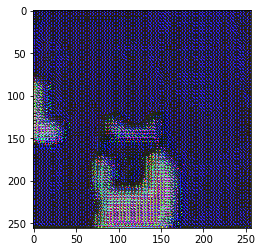

total loss is : 1.0776641368865967
train pcentage:170/5635
transformerNetwork checkpoint file at models/checkpoint_170.pth


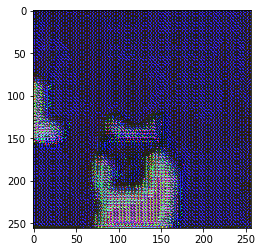

total loss is : 1.2397866249084473
train pcentage:180/5635
transformerNetwork checkpoint file at models/checkpoint_180.pth


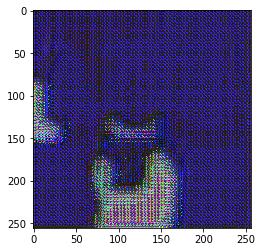

total loss is : 0.9310811758041382
train pcentage:190/5635
transformerNetwork checkpoint file at models/checkpoint_190.pth


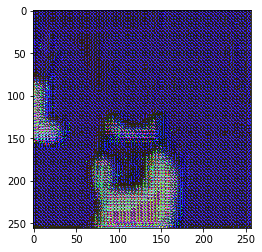

total loss is : 1.046648621559143
train pcentage:200/5635
transformerNetwork checkpoint file at models/checkpoint_200.pth


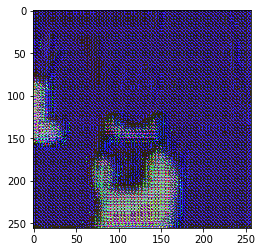

total loss is : 1.0421991348266602
train pcentage:210/5635
transformerNetwork checkpoint file at models/checkpoint_210.pth


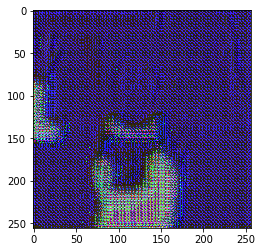

total loss is : 0.9371404647827148
train pcentage:220/5635
transformerNetwork checkpoint file at models/checkpoint_220.pth


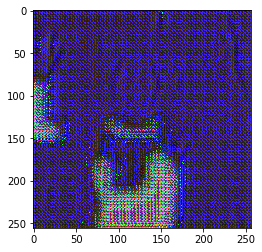

total loss is : 1.1561473608016968
train pcentage:230/5635
transformerNetwork checkpoint file at models/checkpoint_230.pth


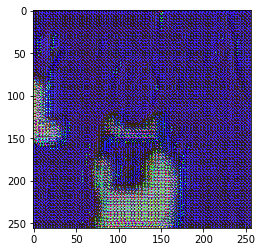

total loss is : 1.1447125673294067
train pcentage:240/5635
transformerNetwork checkpoint file at models/checkpoint_240.pth


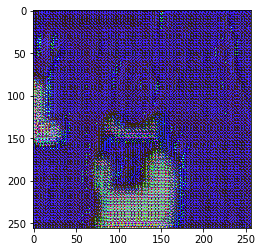

total loss is : 1.2006888389587402
train pcentage:250/5635
transformerNetwork checkpoint file at models/checkpoint_250.pth


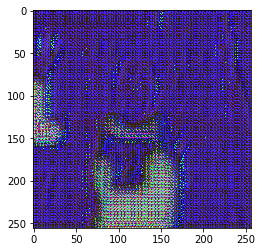

total loss is : 0.8879253268241882
train pcentage:260/5635
transformerNetwork checkpoint file at models/checkpoint_260.pth


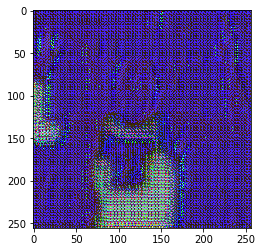

total loss is : 1.1562182903289795
train pcentage:270/5635
transformerNetwork checkpoint file at models/checkpoint_270.pth


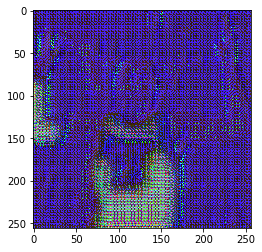

total loss is : 1.0616838932037354
train pcentage:280/5635
transformerNetwork checkpoint file at models/checkpoint_280.pth


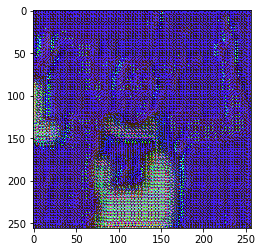

total loss is : 1.1317024230957031
train pcentage:290/5635
transformerNetwork checkpoint file at models/checkpoint_290.pth


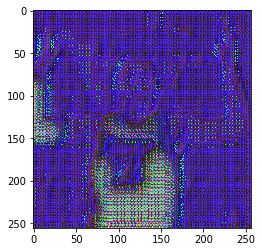

total loss is : 0.9415144324302673
train pcentage:300/5635
transformerNetwork checkpoint file at models/checkpoint_300.pth


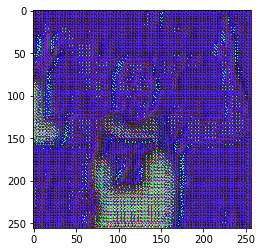

total loss is : 1.1037285327911377
train pcentage:310/5635
transformerNetwork checkpoint file at models/checkpoint_310.pth


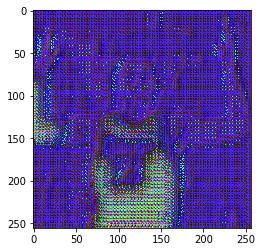

total loss is : 1.0119030475616455
train pcentage:320/5635
transformerNetwork checkpoint file at models/checkpoint_320.pth


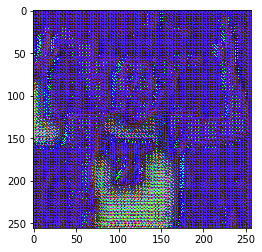

total loss is : 1.067011833190918
train pcentage:330/5635
transformerNetwork checkpoint file at models/checkpoint_330.pth


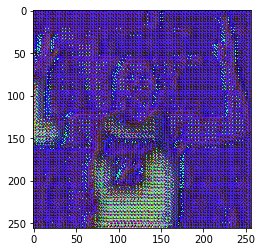

total loss is : 1.0127571821212769
train pcentage:340/5635
transformerNetwork checkpoint file at models/checkpoint_340.pth


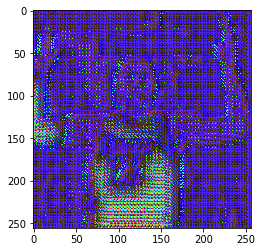

total loss is : 0.898610532283783
train pcentage:350/5635
transformerNetwork checkpoint file at models/checkpoint_350.pth


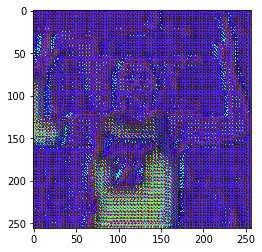

total loss is : 0.7980180382728577
train pcentage:360/5635
transformerNetwork checkpoint file at models/checkpoint_360.pth


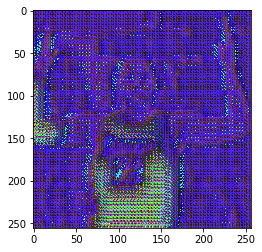

total loss is : 0.8933507204055786
train pcentage:370/5635
transformerNetwork checkpoint file at models/checkpoint_370.pth


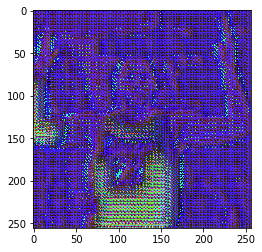

total loss is : 0.9134247899055481
train pcentage:380/5635
transformerNetwork checkpoint file at models/checkpoint_380.pth


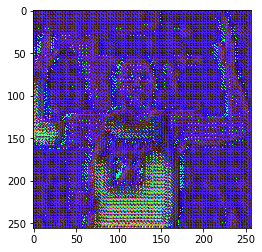

total loss is : 0.8428347706794739
train pcentage:390/5635
transformerNetwork checkpoint file at models/checkpoint_390.pth


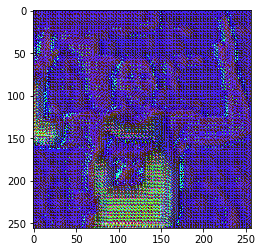

total loss is : 0.8280945420265198
train pcentage:400/5635
transformerNetwork checkpoint file at models/checkpoint_400.pth


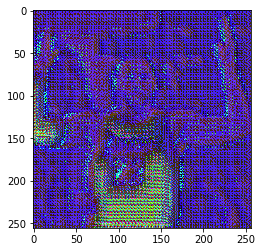

total loss is : 0.9030795097351074
train pcentage:410/5635
transformerNetwork checkpoint file at models/checkpoint_410.pth


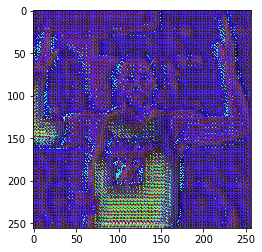

total loss is : 0.9117239713668823
train pcentage:420/5635
transformerNetwork checkpoint file at models/checkpoint_420.pth


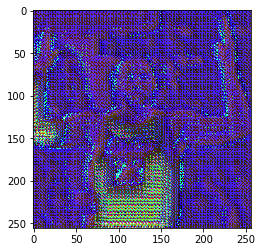

total loss is : 0.7779770493507385
train pcentage:430/5635
transformerNetwork checkpoint file at models/checkpoint_430.pth


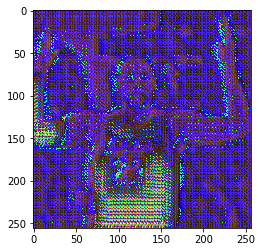

total loss is : 0.7247084379196167
train pcentage:440/5635
transformerNetwork checkpoint file at models/checkpoint_440.pth


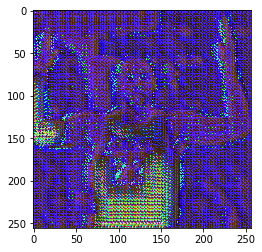

total loss is : 0.7949100732803345
train pcentage:450/5635
transformerNetwork checkpoint file at models/checkpoint_450.pth


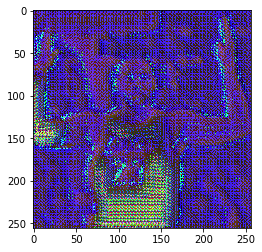

total loss is : 0.7649097442626953
train pcentage:460/5635
transformerNetwork checkpoint file at models/checkpoint_460.pth


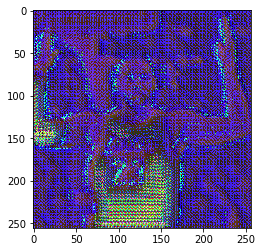

total loss is : 0.7332982420921326
train pcentage:470/5635
transformerNetwork checkpoint file at models/checkpoint_470.pth


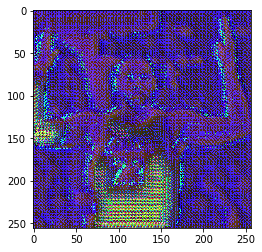

total loss is : 0.9685438871383667
train pcentage:480/5635
transformerNetwork checkpoint file at models/checkpoint_480.pth


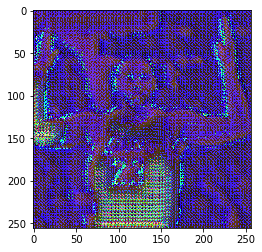

total loss is : 0.9207708239555359
train pcentage:490/5635
transformerNetwork checkpoint file at models/checkpoint_490.pth


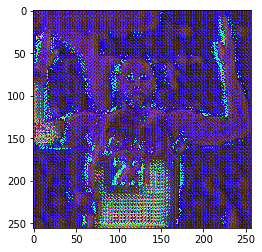

total loss is : 0.9806156754493713
train pcentage:500/5635
transformerNetwork checkpoint file at models/checkpoint_500.pth


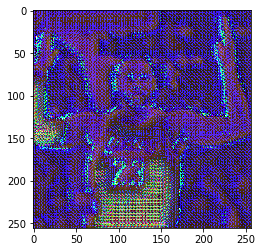

total loss is : 0.6956035494804382
train pcentage:510/5635
transformerNetwork checkpoint file at models/checkpoint_510.pth


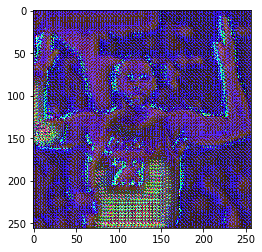

total loss is : 0.9409132599830627
train pcentage:520/5635
transformerNetwork checkpoint file at models/checkpoint_520.pth


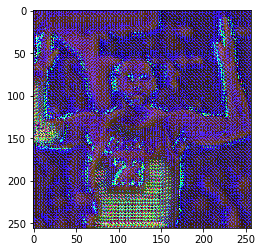

total loss is : 0.8167807459831238
train pcentage:530/5635
transformerNetwork checkpoint file at models/checkpoint_530.pth


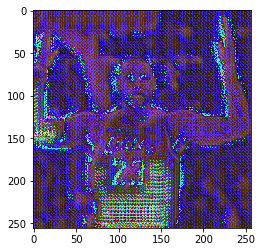

total loss is : 0.8188986778259277
train pcentage:540/5635
transformerNetwork checkpoint file at models/checkpoint_540.pth


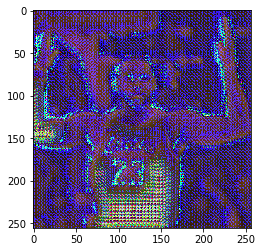

total loss is : 0.786095142364502
train pcentage:550/5635
transformerNetwork checkpoint file at models/checkpoint_550.pth


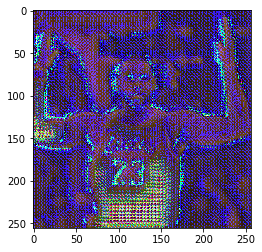

total loss is : 0.6510297656059265
train pcentage:560/5635
transformerNetwork checkpoint file at models/checkpoint_560.pth


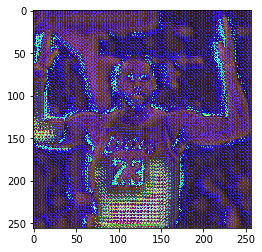

total loss is : 0.746260404586792
train pcentage:570/5635
transformerNetwork checkpoint file at models/checkpoint_570.pth


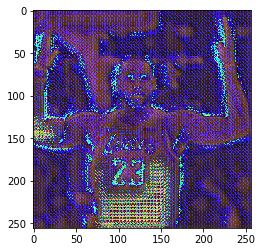

total loss is : 0.773904025554657
train pcentage:580/5635
transformerNetwork checkpoint file at models/checkpoint_580.pth


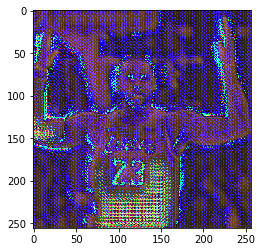

total loss is : 0.7564312219619751
train pcentage:590/5635
transformerNetwork checkpoint file at models/checkpoint_590.pth


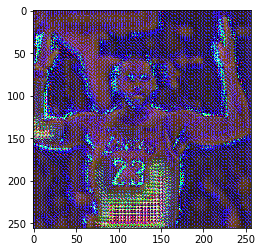

total loss is : 0.7363817691802979
train pcentage:600/5635
transformerNetwork checkpoint file at models/checkpoint_600.pth


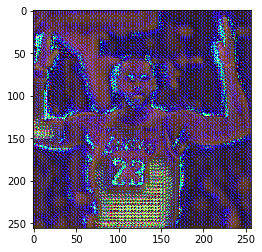

total loss is : 0.7620567679405212
train pcentage:610/5635
transformerNetwork checkpoint file at models/checkpoint_610.pth


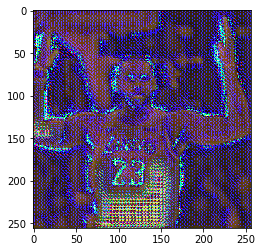

total loss is : 0.6956884264945984
train pcentage:620/5635
transformerNetwork checkpoint file at models/checkpoint_620.pth


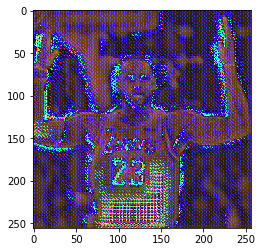

total loss is : 0.8635022640228271
train pcentage:630/5635
transformerNetwork checkpoint file at models/checkpoint_630.pth


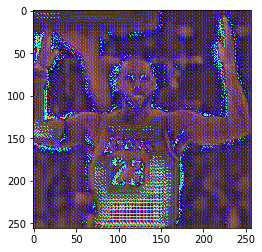

total loss is : 0.6390796303749084
train pcentage:640/5635
transformerNetwork checkpoint file at models/checkpoint_640.pth


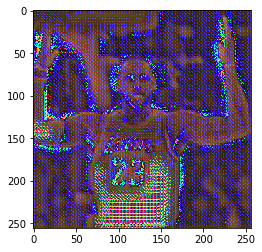

total loss is : 0.8404655456542969
train pcentage:650/5635
transformerNetwork checkpoint file at models/checkpoint_650.pth


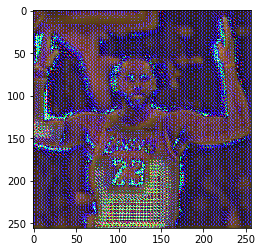

total loss is : 0.6285438537597656
train pcentage:660/5635
transformerNetwork checkpoint file at models/checkpoint_660.pth


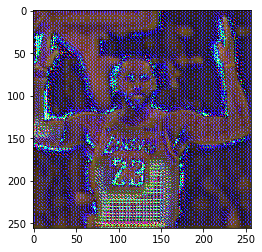

total loss is : 0.7475438117980957
train pcentage:670/5635
transformerNetwork checkpoint file at models/checkpoint_670.pth


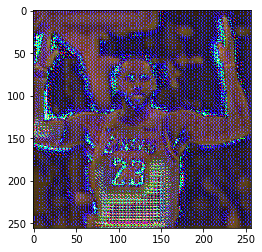

total loss is : 0.7018976807594299
train pcentage:680/5635
transformerNetwork checkpoint file at models/checkpoint_680.pth


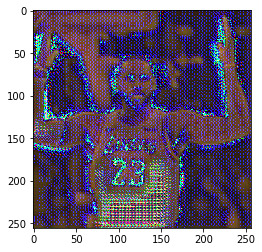

total loss is : 0.6661399006843567
train pcentage:690/5635
transformerNetwork checkpoint file at models/checkpoint_690.pth


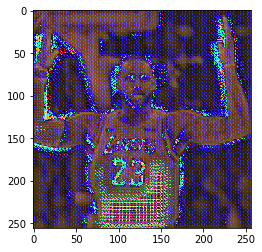

total loss is : 0.6920441389083862
train pcentage:700/5635
transformerNetwork checkpoint file at models/checkpoint_700.pth


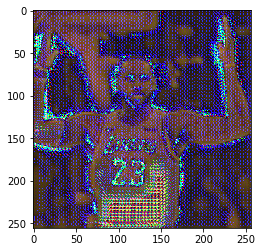

total loss is : 0.6330723762512207
train pcentage:710/5635
transformerNetwork checkpoint file at models/checkpoint_710.pth


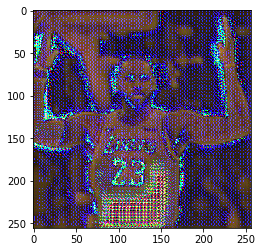

total loss is : 0.7425110340118408
train pcentage:720/5635
transformerNetwork checkpoint file at models/checkpoint_720.pth


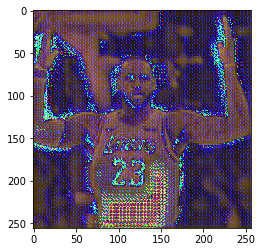

total loss is : 0.7280011177062988
train pcentage:730/5635
transformerNetwork checkpoint file at models/checkpoint_730.pth


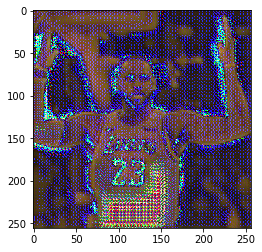

total loss is : 0.6219646334648132
train pcentage:740/5635
transformerNetwork checkpoint file at models/checkpoint_740.pth


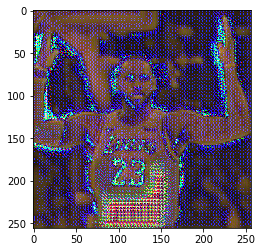

total loss is : 0.6923155784606934
train pcentage:750/5635
transformerNetwork checkpoint file at models/checkpoint_750.pth


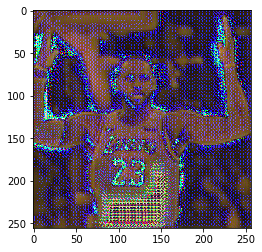

total loss is : 0.5509622097015381
train pcentage:760/5635
transformerNetwork checkpoint file at models/checkpoint_760.pth


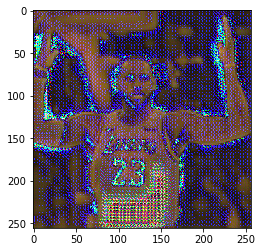

total loss is : 0.7130552530288696
train pcentage:770/5635
transformerNetwork checkpoint file at models/checkpoint_770.pth


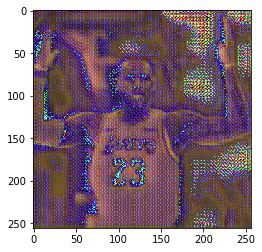

total loss is : 0.8099188804626465
train pcentage:780/5635
transformerNetwork checkpoint file at models/checkpoint_780.pth


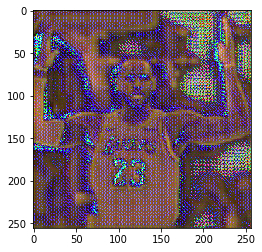

total loss is : 0.6182064414024353
train pcentage:790/5635
transformerNetwork checkpoint file at models/checkpoint_790.pth


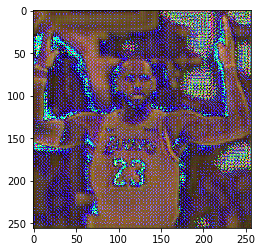

total loss is : 0.7523009181022644
train pcentage:800/5635
transformerNetwork checkpoint file at models/checkpoint_800.pth


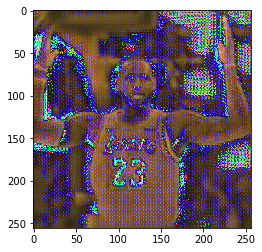

total loss is : 0.6677579283714294
train pcentage:810/5635
transformerNetwork checkpoint file at models/checkpoint_810.pth


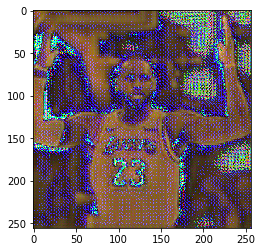

total loss is : 0.6264855265617371
train pcentage:820/5635
transformerNetwork checkpoint file at models/checkpoint_820.pth


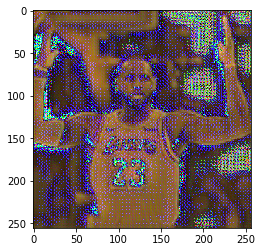

total loss is : 0.5547897815704346
train pcentage:830/5635
transformerNetwork checkpoint file at models/checkpoint_830.pth


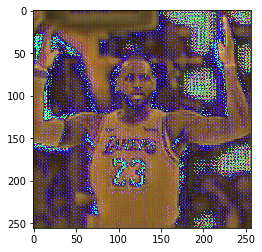

total loss is : 0.5914351344108582
train pcentage:840/5635
transformerNetwork checkpoint file at models/checkpoint_840.pth


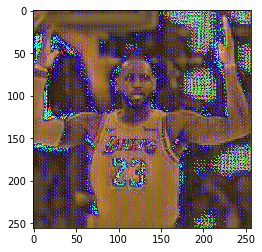

total loss is : 0.4869365096092224
train pcentage:850/5635
transformerNetwork checkpoint file at models/checkpoint_850.pth


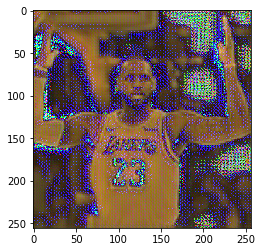

total loss is : 0.643673837184906
train pcentage:860/5635
transformerNetwork checkpoint file at models/checkpoint_860.pth


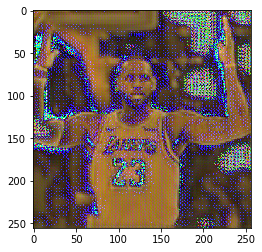

total loss is : 0.6749182939529419
train pcentage:870/5635
transformerNetwork checkpoint file at models/checkpoint_870.pth


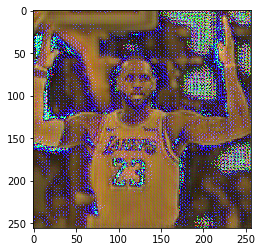

total loss is : 0.5351070165634155
train pcentage:880/5635
transformerNetwork checkpoint file at models/checkpoint_880.pth


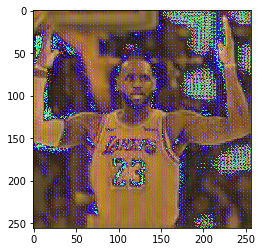

total loss is : 0.6003603935241699
train pcentage:890/5635
transformerNetwork checkpoint file at models/checkpoint_890.pth


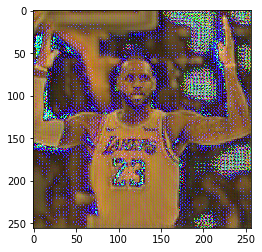

total loss is : 0.6022323966026306
train pcentage:900/5635
transformerNetwork checkpoint file at models/checkpoint_900.pth


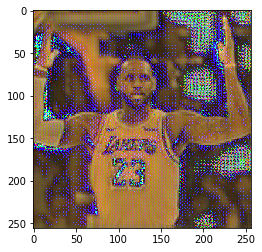

total loss is : 0.5670117139816284
train pcentage:910/5635
transformerNetwork checkpoint file at models/checkpoint_910.pth


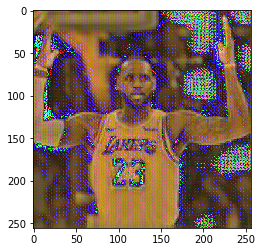

total loss is : 0.6158618330955505
train pcentage:920/5635
transformerNetwork checkpoint file at models/checkpoint_920.pth


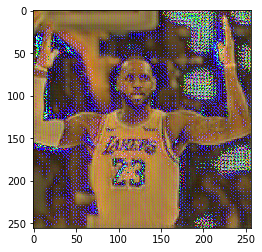

total loss is : 0.4739728569984436
train pcentage:930/5635
transformerNetwork checkpoint file at models/checkpoint_930.pth


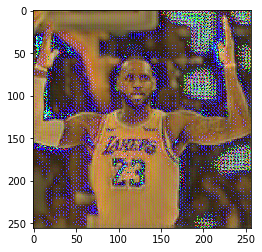

total loss is : 0.5899994373321533
train pcentage:940/5635
transformerNetwork checkpoint file at models/checkpoint_940.pth


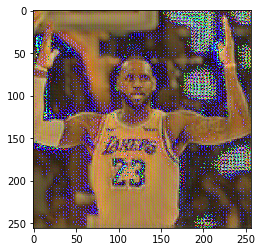

total loss is : 0.604744017124176
train pcentage:950/5635
transformerNetwork checkpoint file at models/checkpoint_950.pth


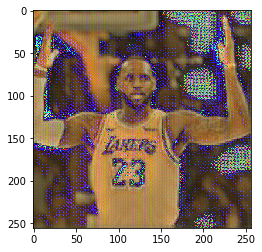

total loss is : 0.5837517380714417
train pcentage:960/5635
transformerNetwork checkpoint file at models/checkpoint_960.pth


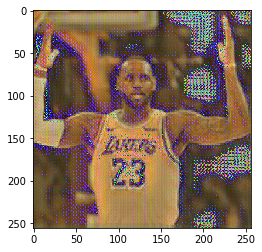

total loss is : 0.6585065722465515
train pcentage:970/5635
transformerNetwork checkpoint file at models/checkpoint_970.pth


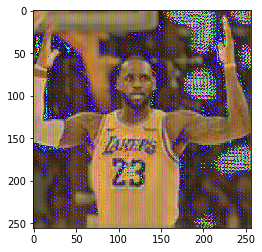

total loss is : 0.6256306767463684
train pcentage:980/5635
transformerNetwork checkpoint file at models/checkpoint_980.pth


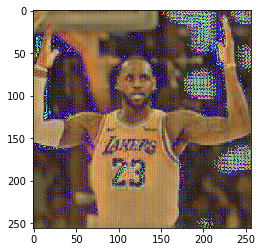

total loss is : 0.6174705028533936
train pcentage:990/5635
transformerNetwork checkpoint file at models/checkpoint_990.pth


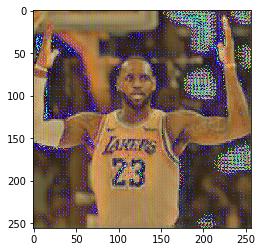

total loss is : 0.5688610672950745
train pcentage:1000/5635
transformerNetwork checkpoint file at models/checkpoint_1000.pth


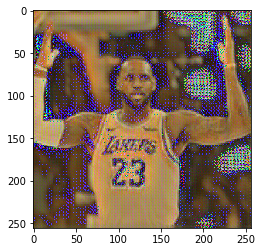

total loss is : 0.6166380643844604
train pcentage:1010/5635
transformerNetwork checkpoint file at models/checkpoint_1010.pth


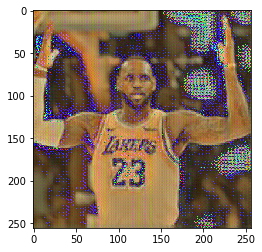

total loss is : 0.5684993863105774
train pcentage:1020/5635
transformerNetwork checkpoint file at models/checkpoint_1020.pth


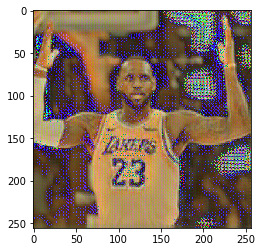

total loss is : 0.5379316806793213
train pcentage:1030/5635
transformerNetwork checkpoint file at models/checkpoint_1030.pth


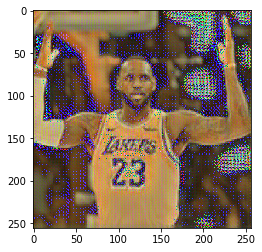

total loss is : 0.544072687625885
train pcentage:1040/5635
transformerNetwork checkpoint file at models/checkpoint_1040.pth


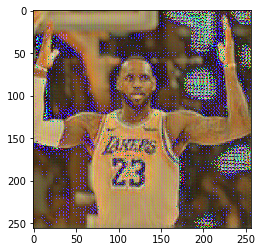

total loss is : 0.5675279498100281
train pcentage:1050/5635
transformerNetwork checkpoint file at models/checkpoint_1050.pth


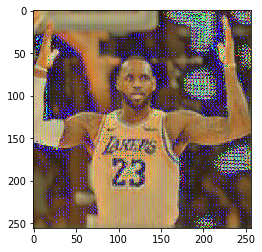

total loss is : 0.5178117752075195
train pcentage:1060/5635
transformerNetwork checkpoint file at models/checkpoint_1060.pth


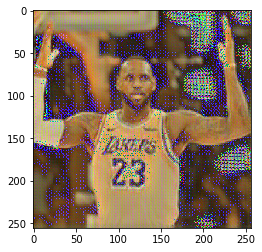

total loss is : 0.5169763565063477
train pcentage:1070/5635
transformerNetwork checkpoint file at models/checkpoint_1070.pth


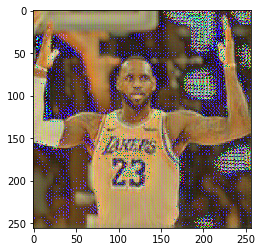

total loss is : 0.47030138969421387
train pcentage:1080/5635
transformerNetwork checkpoint file at models/checkpoint_1080.pth


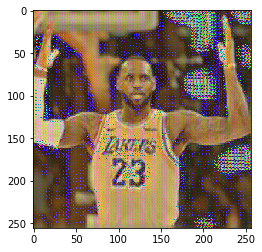

total loss is : 0.44907331466674805
train pcentage:1090/5635
transformerNetwork checkpoint file at models/checkpoint_1090.pth


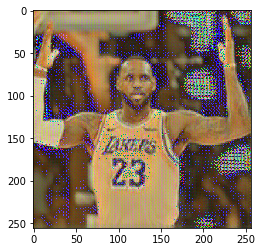

total loss is : 0.47130411863327026
train pcentage:1100/5635
transformerNetwork checkpoint file at models/checkpoint_1100.pth


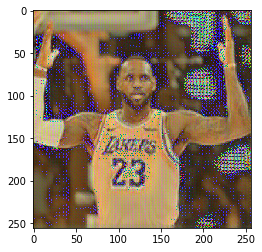

total loss is : 0.5245227813720703
train pcentage:1110/5635
transformerNetwork checkpoint file at models/checkpoint_1110.pth


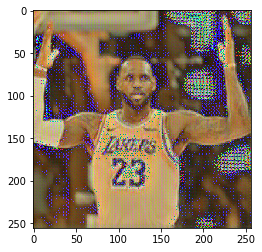

total loss is : 0.4592914581298828
train pcentage:1120/5635
transformerNetwork checkpoint file at models/checkpoint_1120.pth


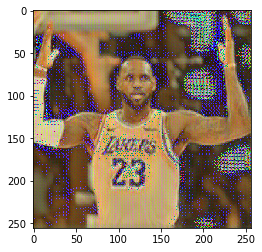

total loss is : 0.4621329605579376
train pcentage:1130/5635
transformerNetwork checkpoint file at models/checkpoint_1130.pth


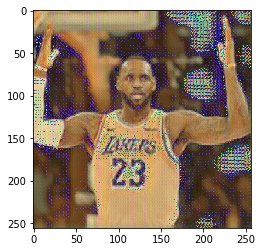

total loss is : 0.6266850233078003
train pcentage:1140/5635
transformerNetwork checkpoint file at models/checkpoint_1140.pth


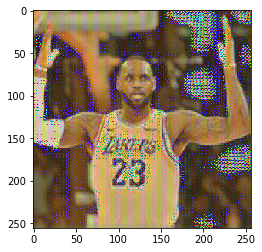

total loss is : 0.48890888690948486
train pcentage:1150/5635
transformerNetwork checkpoint file at models/checkpoint_1150.pth


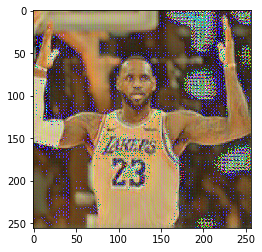

total loss is : 0.6766179203987122
train pcentage:1160/5635
transformerNetwork checkpoint file at models/checkpoint_1160.pth


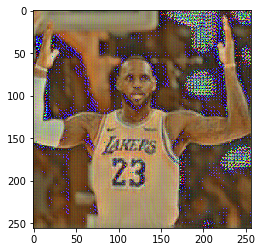

total loss is : 0.5544148683547974
train pcentage:1170/5635
transformerNetwork checkpoint file at models/checkpoint_1170.pth


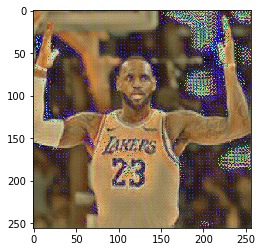

total loss is : 0.5809383392333984
train pcentage:1180/5635
transformerNetwork checkpoint file at models/checkpoint_1180.pth


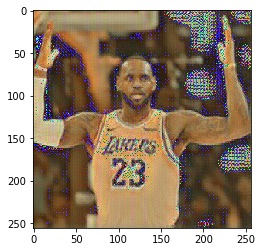

total loss is : 0.5140585899353027
train pcentage:1190/5635
transformerNetwork checkpoint file at models/checkpoint_1190.pth


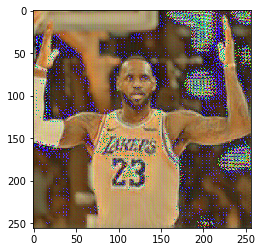

total loss is : 0.4823753237724304
train pcentage:1200/5635
transformerNetwork checkpoint file at models/checkpoint_1200.pth


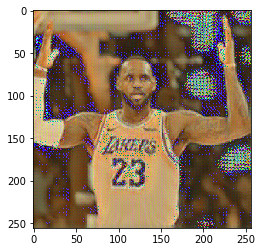

total loss is : 0.48800477385520935
train pcentage:1210/5635
transformerNetwork checkpoint file at models/checkpoint_1210.pth


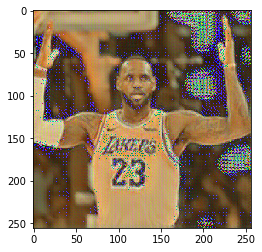

total loss is : 0.41267964243888855
train pcentage:1220/5635
transformerNetwork checkpoint file at models/checkpoint_1220.pth


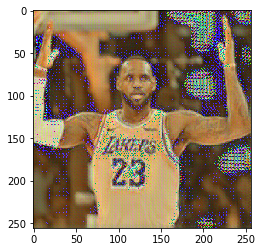

total loss is : 0.4876134693622589
train pcentage:1230/5635
transformerNetwork checkpoint file at models/checkpoint_1230.pth


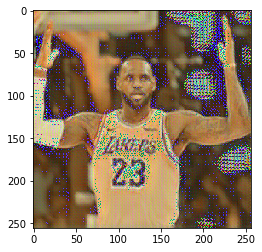

total loss is : 0.49960529804229736
train pcentage:1240/5635
transformerNetwork checkpoint file at models/checkpoint_1240.pth


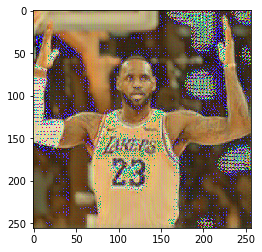

total loss is : 0.5031958818435669
train pcentage:1250/5635
transformerNetwork checkpoint file at models/checkpoint_1250.pth


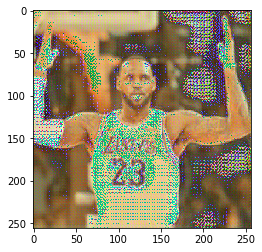

total loss is : 0.5320910215377808
train pcentage:1260/5635
transformerNetwork checkpoint file at models/checkpoint_1260.pth


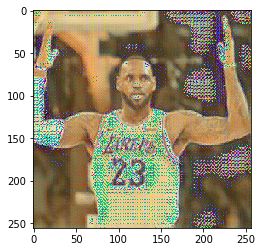

In [0]:
dataset_path = "dataset"
model_path = "saved_models/"
image_path = "stored_image/out/"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
cnn = models.vgg19(pretrained=True).features.to(device).eval()

image_transformer = transforms.Compose([
transforms.Resize(256),  # scale imported image
transforms.CenterCrop(256),
transforms.ToTensor()])  # transform it into a torch tensor

def image_show(tensor, title=None):
    image_untransformer = transforms.ToPILImage()
    image = tensor.cpu().clone() 
    image = image.squeeze(0)     
    image = image_untransformer(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)
    plt.pause(0.001) 

def image_loader(image_name):
    image = Image.open(image_name)
    image = image_transformer(image).unsqueeze(0)
    return image.to(device, torch.float)

style_img = image_loader("images/picasso.png")
check_img = image_loader("images/lebron.jpg")

# extend image with batch size
a, b, c, d = style_img.shape
style_img = style_img.expand(8, b, c, d)

def train_transformer(cnn, style_img, style_weight=1000000, content_weight=1):

    # prepare dataloader
    train_dataset = datasets.ImageFolder(dataset_path, transform=image_transformer)
    train_loader = torch.utils.data.DataLoader(train_dataset, batch_size = 8, shuffle=True)

    # Optimizer settings

    print('Training the style transfer model..')
    print("Using Adams as optimizer")
    transformerNetwork = TransformerNetwork().to(device)
    optimizer = optim.Adam(transformerNetwork.parameters())
    print('Start Optimization')
    count = 0
    print("length of train_loader {}".format(len(train_loader)))
    for input_img, i in train_loader:
          optimizer.zero_grad()
          torch.cuda.empty_cache()

          # Load networks and generate transformed pictures
          transformed_img = transformerNetwork(input_img.to(device))

          # get style loss and content loss
          model_VGG, style_losses, content_losses = get_model(cnn, style_img, input_img.to(device))
          model_VGG(transformed_img)

          # Using the sum of style_loss.loss to caculate the style loss score 
          style_loss_score=[style_loss.loss for style_loss in style_losses]

          # Using the sum of content_loss.loss to caculate the content_loss score 
          content_loss_score=[content_loss.loss for content_loss in content_losses]
          style_loss_score=torch.stack(style_loss_score).sum()
          content_loss_score=torch.stack(content_loss_score).sum()

          # using the weight of style loss and content loss to caculate the total loss
          loss = style_weight*style_loss_score + content_weight*content_loss_score
          loss.backward()
          optimizer.step()
          count +=1

          # track loss
          if (count % 10 == 0):
              print("total loss is : {}".format(loss))
              print("train pcentage:{}/{}".format(count, len(train_loader)))

              # Save Model
              checkpoint_path = "saved_models/" + "checkpoint_" + str(count) + ".pth"
              torch.save(transformerNetwork.state_dict(), checkpoint_path)
              print("transformerNetwork checkpoint file at {}".format(checkpoint_path))   

              # check the effect of transformer
              transformed_check_img = transformerNetwork(check_img)
              plt.figure
              image_show(transformed_check_img)

    
    # Save TransformerNetwork weights
    transformerNetwork.eval()
    transformerNetwork.cpu()
    final_path = model_path + "transformer_weight.pth"
    torch.save(transformerNetwork.state_dict(), final_path)

train_transformer(cnn, style_img)